In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [26]:
df1=pd.read_csv('historical_data.csv')
df2=pd.read_csv('fear_greed_index.csv')
df2=df2.drop(columns='timestamp')
df2['date']=pd.to_datetime(df2['date'],format='%Y-%m-%d')
df1['Date_of_trading']=df1['Timestamp IST'].str.split(' ').str[0]
df1['Time_of_trading']=df1['Timestamp IST'].str.split(' ').str[1]
df1['Date_of_trading']=pd.to_datetime(df1['Date_of_trading'], format="%d-%m-%Y")
df1['Trading_hour']=pd.to_datetime(df1['Time_of_trading']).dt.hour
df1['Trading_minute']=pd.to_datetime(df1['Time_of_trading']).dt.minute
df1=df1.drop(columns=['Time_of_trading','Timestamp'],axis=1)
df1['Trading_year']=df1['Date_of_trading'].dt.year
df1['Trading_month']=df1['Date_of_trading'].dt.month
df1['Trading_day']=df1['Date_of_trading'].dt.day
# df1=df1.drop(columns='Date_of_trading')
df1=df1.drop(columns='Timestamp IST',axis=1)
df2['year']=df2['date'].dt.year
df2['month']=df2['date'].dt.month
df2['day']=df2['date'].dt.day
# df2=df2.drop(columns='date',axis=1)

C:\Users\Abhi9\AppData\Local\Temp\ipykernel_13788\3345578297.py:8: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df1['Trading_hour']=pd.to_datetime(df1['Time_of_trading']).dt.hour
C:\Users\Abhi9\AppData\Local\Temp\ipykernel_13788\3345578297.py:9: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df1['Trading_minute']=pd.to_datetime(df1['Time_of_trading']).dt.minute


In [3]:
df1.shape

(211224, 20)

In [27]:
df=df1.merge(df2[['date', 'value', 'classification']], left_on='Date_of_trading', right_on='date', how='left').drop(columns='date')
df['Trading_year']=df['Date_of_trading'].dt.year
df['Trading_month']=df['Date_of_trading'].dt.month
df['Trading_day']=df['Date_of_trading'].dt.day
# df=df.drop(columns=['Date_of_trading','Time_of_trading'])
df=df[~df['classification'].isna()] # 6 rows with nan values

In [28]:
df.drop(columns=['Date_of_trading','value'],inplace=True)

In [5]:
df.columns

Index(['Account', 'Coin', 'Execution Price', 'Size Tokens', 'Size USD', 'Side',
       'Start Position', 'Direction', 'Closed PnL', 'Transaction Hash',
       'Order ID', 'Crossed', 'Fee', 'Trade ID', 'Trading_hour',
       'Trading_minute', 'Trading_year', 'Trading_month', 'Trading_day',
       'classification'],
      dtype='object')

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 211218 entries, 0 to 211223
Data columns (total 20 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   Account           211218 non-null  object 
 1   Coin              211218 non-null  object 
 2   Execution Price   211218 non-null  float64
 3   Size Tokens       211218 non-null  float64
 4   Size USD          211218 non-null  float64
 5   Side              211218 non-null  object 
 6   Start Position    211218 non-null  float64
 7   Direction         211218 non-null  object 
 8   Closed PnL        211218 non-null  float64
 9   Transaction Hash  211218 non-null  object 
 10  Order ID          211218 non-null  int64  
 11  Crossed           211218 non-null  bool   
 12  Fee               211218 non-null  float64
 13  Trade ID          211218 non-null  float64
 14  Trading_hour      211218 non-null  int32  
 15  Trading_minute    211218 non-null  int32  
 16  Trading_year      211218 

In [7]:
df.head()

,Account,Coin,Execution Price,Size Tokens,Size USD,Side,Start Position,Direction,Closed PnL,Transaction Hash,Order ID,Crossed,Fee,Trade ID,Trading_hour,Trading_minute,Trading_year,Trading_month,Trading_day,classification
0,0xae5eacaf9c6b9111fd53034a602c192a04e082ed,@107,7.9769,986.87,7872.16,BUY,0.000000,Buy,0.0,0xec09451986a1874e3a980418412fcd0201f500c95bac...,52017706630,True,0.345404,8.950000e+14,22,50,2024,12,2,Extreme Greed
1,0xae5eacaf9c6b9111fd53034a602c192a04e082ed,@107,7.9800,16.00,127.68,BUY,986.524596,Buy,0.0,0xec09451986a1874e3a980418412fcd0201f500c95bac...,52017706630,True,0.005600,4.430000e+14,22,50,2024,12,2,Extreme Greed
2,0xae5eacaf9c6b9111fd53034a602c192a04e082ed,@107,7.9855,144.09,1150.63,BUY,1002.518996,Buy,0.0,0xec09451986a1874e3a980418412fcd0201f500c95bac...,52017706630,True,0.050431,6.600000e+14,22,50,2024,12,2,Extreme Greed
3,0xae5eacaf9c6b9111fd53034a602c192a04e082ed,@107,7.9874,142.98,1142.04,BUY,1146.558564,Buy,0.0,0xec09451986a1874e3a980418412fcd0201f500c95bac...,52017706630,True,0.050043,1.080000e+15,22,50,2024,12,2,Extreme Greed
4,0xae5eacaf9c6b9111fd53034a602c192a04e082ed,@107,7.9894,8.73,69.75,BUY,1289.488521,Buy,0.0,0xec09451986a1874e3a980418412fcd0201f500c95bac...,52017706630,True,0.003055,1.050000e+15,22,50,2024,12,2,Extreme Greed


In [ ]:
top_coins=pd.DataFrame(df['Coin'].value_counts().sort_values(ascending=False).head(20)).reset_index() # covering 83 % of data

In [14]:
top_coins

,Coin,count
0,HYPE,68005
1,@107,29992
2,BTC,26064
3,ETH,11158
4,SOL,10691
5,FARTCOIN,4650
6,MELANIA,4428
7,PURR/USDC,2774
8,WLD,1983
9,SUI,1979


In [ ]:
#encoding
df['Coin_grouped'] = df['Coin'].apply(lambda x: x if x in top_coins['Coin'].to_list() else 'Other')
frequency_map = df['Coin_grouped'].value_counts(normalize=True).to_dict() # Didn't perform OneHotEncoding because more the categories, more the risk of saparsity of data

In [31]:
df['Coin_encoded']=df['Coin_grouped'].map(frequency_map)

In [9]:
df['Coin_grouped'].unique()

array(['@107', 'Other', 'HYPE', 'SOL', 'SUI', 'ETH', 'kPEPE', 'TRUMP',
       'ONDO', 'XRP', 'BTC', 'PURR/USDC', 'ZRO', 'WLD', 'kBONK', 'PURR',
       'FARTCOIN', 'MELANIA', '@142', 'FTT', 'PAXG'], dtype=object)

In [32]:
df.drop(columns=['Coin','Coin_grouped'],axis=1,inplace=True)

In [ ]:
df['Side_encoded'] = df['Side'].map({'BUY': 1, 'SELL': 0}) # Ordinal encoding

In [34]:
direction_map=df['Direction'].value_counts(normalize=True).to_dict()
df['Direction_encoded'] = df['Direction'].map(direction_map)

In [35]:
df['Crossed']=df['Crossed'].astype(int)

In [36]:
classification_map=df['classification'].value_counts(normalize=True).to_dict()
df['classification'] = df['classification'].map(classification_map)

In [37]:
df.drop(columns=['Side','Direction'],axis=1,inplace=True)

In [25]:
df.head()

,Account,Execution Price,Size Tokens,Size USD,Start Position,Closed PnL,Transaction Hash,Order ID,Crossed,Fee,Trade ID,Trading_hour,Trading_minute,Trading_year,Trading_month,Trading_day,classification,Coin_encoded,Side_encoded,Direction_encoded
0,0xae5eacaf9c6b9111fd53034a602c192a04e082ed,7.9769,986.87,7872.16,0.000000,0.0,0xec09451986a1874e3a980418412fcd0201f500c95bac...,52017706630,1,0.345404,8.950000e+14,22,50,2024,12,2,0.18934,0.141995,1,0.079141
1,0xae5eacaf9c6b9111fd53034a602c192a04e082ed,7.9800,16.00,127.68,986.524596,0.0,0xec09451986a1874e3a980418412fcd0201f500c95bac...,52017706630,1,0.005600,4.430000e+14,22,50,2024,12,2,0.18934,0.141995,1,0.079141
2,0xae5eacaf9c6b9111fd53034a602c192a04e082ed,7.9855,144.09,1150.63,1002.518996,0.0,0xec09451986a1874e3a980418412fcd0201f500c95bac...,52017706630,1,0.050431,6.600000e+14,22,50,2024,12,2,0.18934,0.141995,1,0.079141
3,0xae5eacaf9c6b9111fd53034a602c192a04e082ed,7.9874,142.98,1142.04,1146.558564,0.0,0xec09451986a1874e3a980418412fcd0201f500c95bac...,52017706630,1,0.050043,1.080000e+15,22,50,2024,12,2,0.18934,0.141995,1,0.079141
4,0xae5eacaf9c6b9111fd53034a602c192a04e082ed,7.9894,8.73,69.75,1289.488521,0.0,0xec09451986a1874e3a980418412fcd0201f500c95bac...,52017706630,1,0.003055,1.050000e+15,22,50,2024,12,2,0.18934,0.141995,1,0.079141


In [ ]:
df.drop(columns=['Account','Transaction Hash'],axis=1,inplace=True) 

In [27]:
df.shape

(211218, 18)

In [ ]:
from sklearn.preprocessing import RobustScaler # in this data there are many outliers but they are important for my analysis so used RobustScaler instead of StandardScaler
rs=RobustScaler(quantile_range=(25,100))

In [39]:
li=['Crossed' , 'Trading_year' , 'Trading_month' , 'Trading_day' , 'Trading_hour' , 'Trading_minute' ,'classification' , 'Coin_encoded' , 'Side_encoded' , 'Direction_encoded']

In [ ]:
for col in df.columns:
    if col in li:
        continue
    plt.figure(figsize=(15,10))
    plt.title(f'{col} Boxplot')
    sns.boxplot(data=df,x=col)
    plt.show()

In [31]:
df.shape

(211218, 18)

In [ ]:
for col in df.columns:
    if col in li:
        continue
    df[col]=pd.DataFrame(rs.fit_transform(df[[col]])) # Didn't Use ColumnTransformer and Pipeline because only few feature engineering was required

In [41]:
df.head()

,Execution Price,Size Tokens,Size USD,Start Position,Closed PnL,Order ID,Crossed,Fee,Trade ID,Trading_hour,Trading_minute,Trading_year,Trading_month,Trading_day,classification,Coin_encoded,Side_encoded,Direction_encoded
0,-0.000095,0.000060,0.001855,-0.000003,0.0,-0.739489,1,0.000305,0.392226,22,50,2024,12,2,0.18934,0.141995,1,0.079141
1,-0.000094,-0.000001,-0.000120,0.000030,0.0,-0.739489,1,-0.000100,-0.140165,22,50,2024,12,2,0.18934,0.141995,1,0.079141
2,-0.000094,0.000007,0.000141,0.000030,0.0,-0.739489,1,-0.000047,0.115430,22,50,2024,12,2,0.18934,0.141995,1,0.079141
3,-0.000094,0.000007,0.000139,0.000035,0.0,-0.739489,1,-0.000047,0.610130,22,50,2024,12,2,0.18934,0.141995,1,0.079141
4,-0.000094,-0.000001,-0.000134,0.000039,0.0,-0.739489,1,-0.000103,0.574794,22,50,2024,12,2,0.18934,0.141995,1,0.079141


In [ ]:
df.dropna(axis=0,inplace=True)# Having 211218 samples makes my data large enough. So dropping only few samples will not harm

In [ ]:
from sklearn.cluster import KMeans# Thought to utilize DBSCAN but memory allocation is one of the major issue , so applied KMeans

In [ ]:
# Pca
from sklearn.decomposition import PCA #  Altough Feature extraction was not an urgent and necessary step (because 18 features present), but performed to get the minimum number of features required to get a total variance of >90%       
pca=PCA(n_components=3)

In [ ]:
data=pd.DataFrame(pca.fit_transform(df)) # again didn't use ColumnTransformer

In [ ]:
np.cumsum(pca.explained_variance_ratio_) # So only upto 3rd feature is enough to explain the 96% variance of the data

array([0.68526132, 0.84054291, 0.96713267, 0.99742221, 0.99830753,
       0.99889855, 0.99944275, 0.99978652, 0.99995435, 0.99998155,
       0.9999897 , 0.999995  , 0.99999836, 0.99999945, 0.99999975,
       0.99999986, 0.99999996, 1.        ])

In [ ]:
wcss3=[] # While I was performing the ELBOW method , I found mini-batches of my data will help the training faster.
for k in range (25,30):
    print(k)
    km=KMeans(n_clusters=k)
    km.fit_predict(data.iloc[:213,:])
    wcss3.append(km.inertia_)

25
26
27
28
29


c:\Users\Abhi9\.jupyter\conda\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
c:\Users\Abhi9\.jupyter\conda\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
c:\Users\Abhi9\.jupyter\conda\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
c:\Users\Abhi9\.jupyter\conda\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a m

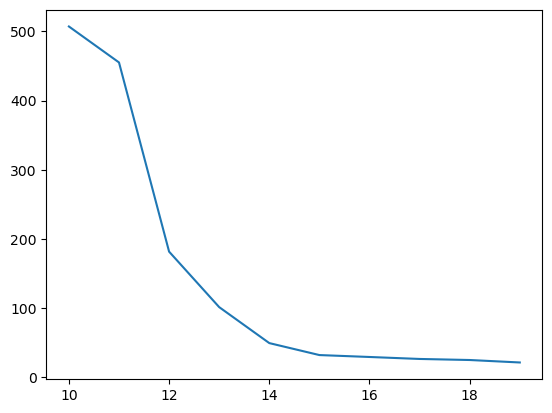

In [ ]:
plt.plot(range(10,20),wcss3) # The first chunk of data needs around 15 clusters but more the chunks more the uncertain of value K . So used K=20 ()

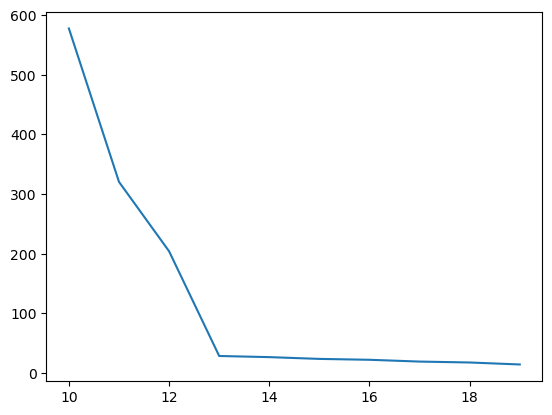

In [ ]:
plt.plot(range(10,20),wcss3) # For chunk with sample index 213 to 427

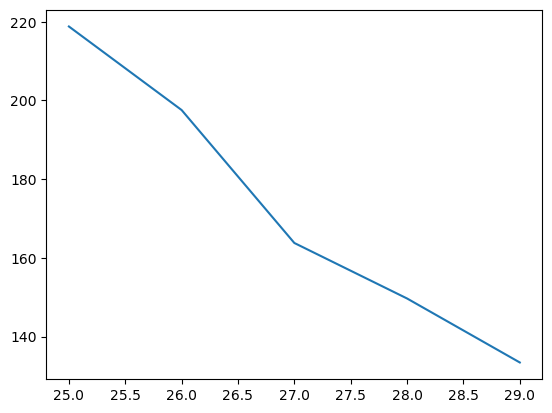

In [ ]:
plt.plot(range(25,30),wcss3) #For chunk with sample index 427 to 640

In [ ]:
from sklearn.cluster import MiniBatchKMeans
mbk = MiniBatchKMeans(n_clusters=20, batch_size=212, random_state=42) 
mbk.fit(df)

c:\Users\Abhi9\.jupyter\conda\Lib\site-packages\sklearn\cluster\_kmeans.py:1955: UserWarning: MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 2560 or by setting the environment variable OMP_NUM_THREADS=1
  warnings.warn(


MiniBatchKMeans(batch_size=212, n_clusters=20, random_state=42)

In [82]:
mbk.labels_

array([ 6,  6,  6, ..., 11, 11, 11])

In [83]:
df['Cluster'] = mbk.fit_predict(df)

c:\Users\Abhi9\.jupyter\conda\Lib\site-packages\sklearn\cluster\_kmeans.py:1955: UserWarning: MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 2560 or by setting the environment variable OMP_NUM_THREADS=1
  warnings.warn(


In [84]:
df.sample(5)

,Execution Price,Size Tokens,Size USD,Start Position,Closed PnL,Order ID,Crossed,Fee,Trade ID,Trading_hour,Trading_minute,Trading_year,Trading_month,Trading_day,classification,Coin_encoded,Side_encoded,Direction_encoded,Cluster
160566,0.000065,7.394563e-07,0.000130,0.001231,0.000044,-0.590060,0,0.000290,-0.595760,13,10,2024,12,19,0.189340,0.141995,0,0.094225,9
135097,-0.000164,1.896042e-07,-0.000149,0.001067,0.000000,-0.538862,1,-0.000092,0.610130,21,0,2024,12,23,0.238157,0.013133,1,0.079141,7
9435,0.805343,-2.020959e-06,0.000374,-0.000001,0.000073,0.440796,0,-0.000107,0.187279,19,50,2025,4,21,0.292764,0.123399,0,0.230463,17
114364,0.852133,-2.022067e-06,-0.000011,-0.000003,-0.000056,0.458166,0,-0.000041,0.371025,19,28,2025,4,23,0.238157,0.009388,1,0.170473,4
165812,0.000073,2.986266e-06,0.000379,0.000169,0.000084,-0.518978,1,0.000639,-0.632038,11,41,2024,12,26,0.189340,0.141995,0,0.094225,5


In [85]:
data['Cluster'] = mbk.fit_predict(df)

c:\Users\Abhi9\.jupyter\conda\Lib\site-packages\sklearn\cluster\_kmeans.py:1955: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 2560 or by setting the environment variable OMP_NUM_THREADS=1



In [86]:
data.columns

Index([0, 1, 2, 'Cluster'], dtype='object')

In [ ]:
import plotly.express as px # 3D interactable plot of Clusters formed in redused dimension data through PCA
clustering=data['Cluster'].astype(str)
px.scatter_3d(data_frame=data,x=0,y=1,z=2,color=clustering,color_discrete_sequence=px.colors.qualitative.G10).show()

In [ ]:
clustering=df['Cluster'].astype(str) # Visualising the high Closed PnL for different clusters
px.scatter_3d(data_frame=df,x='Coin_encoded',y='Start Position',z='Closed PnL',color=clustering,color_discrete_sequence=px.colors.qualitative.G10).show()

In [ ]:
pd.DataFrame(df.groupby('Cluster')['Closed PnL'].mean().sort_values(ascending=False)).index # The cluster priority for greater Closed PnL is highest for cluster 0 and lowest for cluster 17

Index([0, 16, 5, 9, 14, 13, 15, 19, 8, 10, 6, 1, 18, 7, 12, 4, 11, 2, 3, 17], dtype='int32', name='Cluster')